In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from data_utils import WoodDataset
from torch.utils.data import DataLoader
import torchvision.models as models
from torch import nn
import torch
from torch.optim import lr_scheduler
import torch.optim as optim
from torchvision import transforms
from PIL import Image
from copy import deepcopy
import numpy as np

from datetime import datetime
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import classification_report, confusion_matrix

from os import path
from tqdm.notebook import tqdm
import joblib

In [3]:
train_val_test_split_params = {
    'test_size': 0.25,
    'valid_size': 0.25,
    'random_state': 42,
    'stratify': 'target'
}

stats_trans = transforms.Compose([
                transforms.Resize(256),
                transforms.CenterCrop(224),
                transforms.ToTensor(),
            ])

train_dataset = WoodDataset(
    img_dir='data', 
    is_test=False, 
    task_type='classification', 
    dataset_role='train', 
    train_val_test_split_params=train_val_test_split_params,
    img_transforms=stats_trans
)


means = []
stds = []
for idx in tqdm(range(len(train_dataset)), total=len(train_dataset)):
    img = train_dataset[idx]['image']
    means.append(torch.mean(img, dim=(1, 2)))
    stds.append(torch.std(img, dim=(1, 2)))

mean = torch.mean(torch.tensor([m.numpy() for m in means]), dim=0)
std = torch.mean(torch.tensor([s.numpy() for s in stds]), dim=0)

  0%|          | 0/266 [00:00<?, ?it/s]

/tmp/ipykernel_96774/1322741780.py:31: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:210.)
  mean = torch.mean(torch.tensor([m.numpy() for m in means]), dim=0)


In [4]:
mean, std

(tensor([0.6926, 0.6042, 0.5279]), tensor([0.2078, 0.1924, 0.1725]))

In [6]:
# (tensor([0.6926, 0.6042, 0.5279]), tensor([0.2078, 0.1924, 0.1725]))

In [5]:
trans_with_aug = transforms.Compose([
    transforms.AutoAugment(transforms.AutoAugmentPolicy.IMAGENET),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])
trans_without_aug = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

In [6]:
train_dataset = WoodDataset(
    img_dir='data', 
    is_test=False, 
    task_type='classification', 
    dataset_role='train', 
    train_val_test_split_params=train_val_test_split_params,
    img_transforms=trans_with_aug
)
valid_dataset = WoodDataset(
    img_dir='data', 
    is_test=False, 
    task_type='classification', 
    dataset_role='valid', 
    train_val_test_split_params=train_val_test_split_params,
    img_transforms=trans_with_aug
)
test_dataset = WoodDataset(
    img_dir='data', 
    is_test=False, 
    task_type='classification', 
    dataset_role='test', 
    train_val_test_split_params=train_val_test_split_params,
    img_transforms=trans_without_aug
)
submission_dataset = WoodDataset(
    img_dir='data', 
    is_test=True, 
    task_type='classification',
    img_transforms=trans_without_aug
)

In [7]:
batch_size = 32

train_preset = {'batch_size': batch_size, 'shuffle': True, 'num_workers': 0, 'drop_last': True}
test_preset = {'batch_size': 1, 'shuffle': False, 'num_workers': 0, 'drop_last': False}

train_dataloader = DataLoader(train_dataset, **train_preset)
valid_dataloader = DataLoader(valid_dataset, **train_preset)
test_dataloader = DataLoader(test_dataset, **test_preset)
submission_dataloader = DataLoader(submission_dataset, **test_preset)

In [8]:
def layers_freeze(model):
    for name, child in model.named_children():
        for param in child.parameters():
            param.requires_grad = False
        layers_freeze(child)
        
        
def layers_unfreeze(model):
    for name, child in model.named_children():
        for param in child.parameters():
            param.requires_grad = True
        layers_unfreeze(child)

In [9]:
torch.manual_seed(42)

In [10]:
model = models.efficientnet_b7(pretrained=True)
layers_freeze(model)
model.classifier[1] = nn.Linear(model.classifier[1].in_features, 3)

In [11]:
lr = 1e-3

loss = nn.CrossEntropyLoss(reduction='sum')
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = lr_scheduler.StepLR(optimizer, 3, gamma=0.1, last_epoch=-1)

In [77]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
n_epochs = 30
es_num = 10

train_epoch_losses = []
valid_epoch_losses = []
es_counter = 0

wandb.watch(model)

for epoch in range(n_epochs):
    #if epoch == 6:
    #    layers_unfreeze(model)
    #    optimizer = optim.Adam(model.parameters(), lr=lr)
    #    scheduler = lr_scheduler.MultiStepLR(optimizer, gamma=0.1, milestones=[8, 13, 20])
    with tqdm(train_dataloader, unit="batch") as tqdm_train_dataloader:
        model.train()
        train_loss = 0
        train_cnt = 0
        for batch in tqdm_train_dataloader:
            tqdm_train_dataloader.set_description(f"train Epoch {epoch}")
            model.zero_grad()
            images = batch['image'].to(device)
            targets = batch['target'].to(device)
            bath_shape = images.shape[0]
            train_cnt += bath_shape
            
            output = model(images)
            batch_loss = loss(output, targets)
            batch_loss.backward()
            optimizer.step()
            batch_loss_val = batch_loss.detach().item()
            train_loss += batch_loss_val
            tqdm_train_dataloader.set_postfix(
                batch_loss=batch_loss_val / bath_shape,
                epoch_loss=train_loss / train_cnt)
    with torch.no_grad():
        model.eval()
        with tqdm(valid_dataloader, unit="batch") as tqdm_valid_dataloader:
            valid_loss = 0
            valid_cnt = 0
            for batch in tqdm_valid_dataloader:
                tqdm_valid_dataloader.set_description(f"valid Epoch {epoch}")
                images = batch['image'].to(device)
                targets = batch['target'].to(device)
                bath_shape = images.shape[0]
                valid_cnt += bath_shape
            
                output = model(images)
                batch_loss = loss(output, targets)
                
                batch_loss_val = batch_loss.detach().item()
                valid_loss += batch_loss_val
                
                tqdm_valid_dataloader.set_postfix(
                batch_loss=batch_loss_val / bath_shape,
                epoch_loss=valid_loss / valid_cnt)
    train_epoch_losses.append(train_loss / train_cnt)
    valid_epoch_losses.append(valid_loss / valid_cnt)
    now_time_str = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    torch.save(model.state_dict(),
               path.join(
                   'data',
                   'nn_chpt',
                   f'model_{epoch}_{now_time_str}_{round(train_epoch_losses[-1],5)}_{round(valid_epoch_losses[-1],5)}'))
    if (len(valid_epoch_losses) > 1) and (valid_epoch_losses[-1] >= min(valid_epoch_losses[:-1])):
        es_counter += 1
    elif (len(valid_epoch_losses) > 1) and (valid_epoch_losses[-1] < min(valid_epoch_losses[:-1])):
        es_counter = 0
    if es_counter == es_num:
        break


  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

  0%|          | 0/8 [00:00<?, ?batch/s]

  0%|          | 0/4 [00:00<?, ?batch/s]

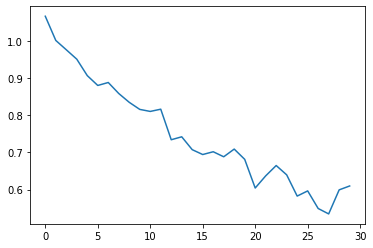

In [80]:
plt.plot(range(30), valid_epoch_losses)

In [12]:
model.load_state_dict(torch.load(path.join(
                   'data',
                   'nn_chpt',
                   'model_29_2022-04-11 09:32:21_0.37724_0.60964'), map_location='cpu'))

<All keys matched successfully>

In [81]:
with torch.no_grad():
    model.eval()
    with tqdm(test_dataloader, unit="batch") as tqdm_test_dataloader:
        valid_loss = 0
        valid_cnt = 0
        pred = []
        true = []
        img_path = []
        for batch in tqdm_test_dataloader:
            images = batch['image'].to(device)
            targets = batch['target'].to(device)
            output = model(images)
            pred.extend(torch.argmax(nn.functional.softmax(output, dim=1), dim=1).detach().numpy().tolist())
            true.extend(targets.detach().numpy().tolist())
            img_path.extend(batch['img_path'])
test_df = pd.DataFrame({'true': true, 'pred': pred, 'img_path': img_path})

  0%|          | 0/134 [00:00<?, ?batch/s]

In [84]:
print(classification_report(test_df.true, test_df.pred))

              precision    recall  f1-score   support

           0       0.86      0.88      0.87        64
           1       0.91      0.75      0.82        53
           2       0.64      0.94      0.76        17

    accuracy                           0.84       134
   macro avg       0.80      0.86      0.82       134
weighted avg       0.85      0.84      0.84       134



In [86]:
confusion_matrix(test_df.true, test_df.pred)

array([[56,  3,  5],
       [ 9, 40,  4],
       [ 0,  1, 16]])

In [89]:
test_df[(test_df.true==0) & (test_df.pred==2)]

,true,pred,img_path
28,0,2,data/train/1/IMG_0986.png
33,0,2,data/train/1/IMG_0720.png
38,0,2,data/train/1/IMG_0593.png
80,0,2,data/train/1/IMG_0848.png
118,0,2,data/train/1/IMG_0906.png


In [101]:
model

EfficientNet(
  (features): Sequential(
    (0): ConvNormActivation(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): ConvNormActivation(
            (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64, bias=False)
            (1): BatchNorm2d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): ConvNormActivatio

In [13]:
class MN(nn.Module):
    def __init__(self, model):
        super(MN, self).__init__()
        
        # get the pretrained VGG19 network
        self.model = deepcopy(model)
        layers_unfreeze(self.model)
        
        # disect the network to access its last convolutional layer
        self.features_conv = self.model.features
        
        # get the max pool of the features stem
        self.pool = self.model.avgpool
        
        # get the classifier of the vgg19
        self.classifier = self.model.classifier
        
        # placeholder for the gradients
        self.gradients = None
    
    # hook for the gradients of the activations
    def activations_hook(self, grad):
        self.gradients = grad
        
    def forward(self, x):
        x = self.features_conv(x)
        
        # register the hook
        #if x.requires_grad:
        h = x.register_hook(self.activations_hook)
        
        # apply the remaining pooling
        x = self.pool(x)
        x = x.view((1, -1))
        x = self.classifier(x)
        return x
    
    # method for the gradient extraction
    def get_activations_gradient(self):
        return self.gradients
    
    # method for the activation exctraction
    def get_activations(self, x):
        return self.features_conv(x)

In [25]:
img = Image.open('data/train/1/IMG_0986.png')

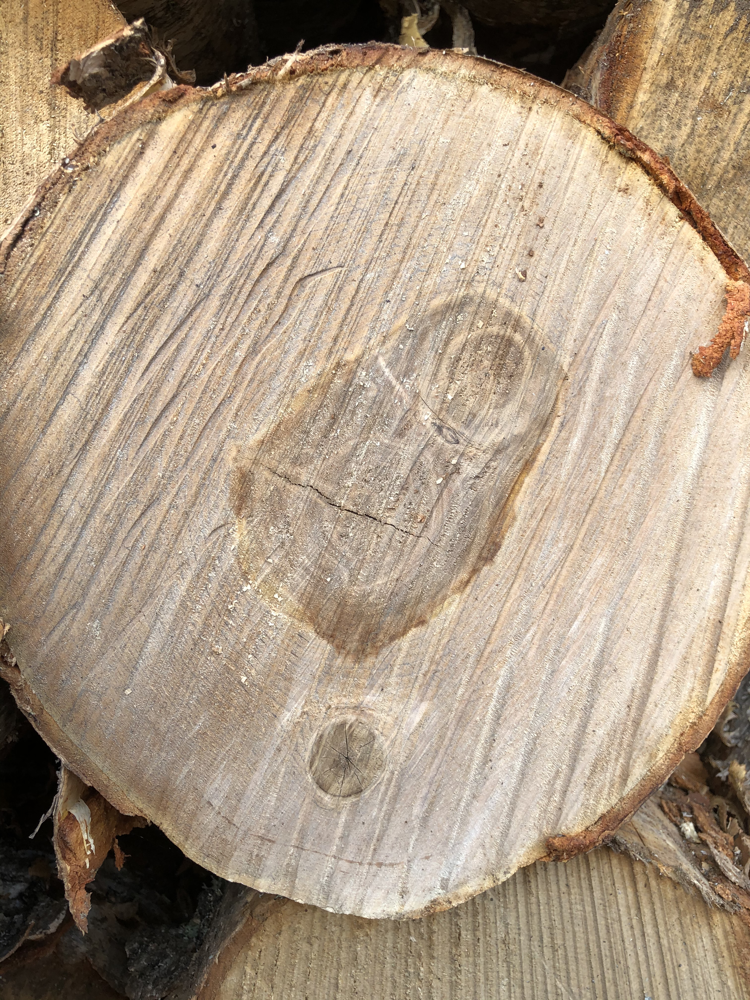

In [26]:
img

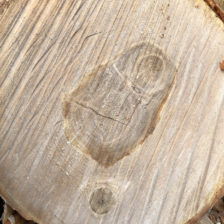

In [18]:
transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224)])(img)

In [22]:
img_t = trans_without_aug(img).unsqueeze(0)
mn = MN(model)
mn.eval()
pred = mn(img_t)#.argmax(dim=1)

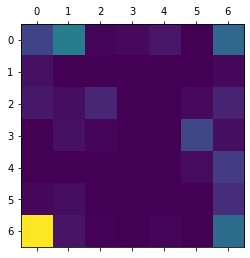

In [23]:
pred[:, 0].backward()

# pull the gradients out of the model
gradients = mn.get_activations_gradient()

# pool the gradients across the channels
pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])

# get the activations of the last convolutional layer
activations = mn.get_activations(img_t).detach()

# weight the channels by corresponding gradients
for i in range(mn.classifier[1].in_features):
    activations[:, i, :, :] *= pooled_gradients[i]
    
# average the channels of the activations
heatmap = torch.mean(activations, dim=1).squeeze()

# relu on top of the heatmap
# expression (2) in https://arxiv.org/pdf/1610.02391.pdf
heatmap = np.maximum(heatmap, 0)

# normalize the heatmap
heatmap /= torch.max(heatmap)

# draw the heatmap
plt.matshow(heatmap.squeeze())

In [24]:
import cv2
heatmap = heatmap.numpy()
img = cv2.imread('data/train/1/IMG_0986.png')
img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img
cv2.imwrite('map.jpg', superimposed_img)

True

In [ ]:
cv2.imshow('image window', superimposed_img)
# add wait key. window waits until user presses a key
cv2.waitKey(0)
# and finally destroy/close all open windows
cv2.destroyAllWindows()

In [28]:
superimposed_img.shape

(4032, 3024, 3)

In [12]:
with torch.no_grad():
    model.eval()
    with tqdm(submission_dataloader, unit="batch") as tqdm_submission_dataloader:
        valid_loss = 0
        valid_cnt = 0
        pred = []
        img_path = []
        for batch in tqdm_submission_dataloader:
            images = batch['image'].to(device)
            output = model(images)
            pred.extend(torch.argmax(nn.functional.softmax(output, dim=1), dim=1).detach().numpy().tolist())
            img_path.extend(batch['img_path'])
test_df = pd.DataFrame({'pred': pred, 'img_path': img_path})

  0%|          | 0/249 [00:00<?, ?batch/s]

In [13]:
backward_mapping = {0: 1, 1: 3, 2: 0}

test_df['id'] = test_df.img_path.map(lambda x: path.split(x)[-1].split('.')[0])
test_df['class'] = test_df.pred.map(lambda x: backward_mapping[x])

In [14]:
test_df[['id', 'class']].to_csv(path.join('data', 'mn_cls_9.csv'), index=False)